In [437]:
#Importar librerías
import pandas as pd
import os
import zipfile
import shutil
import requests
import zipfile
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.ticker import PercentFormatter
import geopandas as gpd
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster
from folium.plugins import HeatMap
from scipy.stats import iqr
import branca
import branca.colormap as cm
from branca.element import Template, MacroElement


In [438]:
#Definir directorio de trabajo
#Directorio de trabajo. Si existe directorio D:/, se selecciona si no, C:/
try:
    os.chdir('C:/users/claud/Documents/GitHub/guerrero_vivi')
except:
    os.chdir('C:/users/claudio.pacheco/Documents/Github/guerrero_vivi')
#if os.path.exists('D:/'):
#    os.chdir('D:/github/proyecto_infotec')
#else:
#    os.chdir('C:/users/claudio.pacheco/Documents/Github/proyecto_infotec')

In [439]:
#crear directorio de salida
if not os.path.exists('datos'):
    os.makedirs('datos')

In [440]:
def download_and_extract(url, filename, check_file_path, extract_path):
    # Checar si el archivo ya existe
    if os.path.isfile(check_file_path):
        print(f"El archivo {filename} existe, no se descargará.")
    else:
        print(f"El archivo {filename} no existe. Descargando.")
        response = requests.get(url)
        with open(filename, "wb") as code:
            code.write(response.content)
        
        # extraer zip
        with zipfile.ZipFile(filename, "r") as zip_ref:
            zip_ref.extractall(extract_path)
        
        # Eliminar zip
        os.remove(filename)

In [441]:
descarga_manzanas=[{"url": "https://www.inegi.org.mx/contenidos/programas/ccpv/2020/microdatos/ageb_manzana/RESAGEBURB_12_2020_csv.zip",
                     "filename": "RESAGEBURB_12_2020_csv.zip",
                        "check_file_path": "datos/conjunto_de_datos/RESAGEBURB_12_2020.csv",
                        "extract_path": "datos"},
                    {"url": "https://www.inegi.org.mx/contenidos/productos/prod_serv/contenidos/espanol/bvinegi/productos/geografia/marcogeo/889463807469/12_guerrero.zip",
                        "filename": "12_guerrero.zip",
                        "check_file_path": "datos/conjunto_de_datos/12m.shp",
                        "extract_path": "datos"}]
for file in descarga_manzanas:
    download_and_extract(file["url"], file["filename"], file["check_file_path"], file["extract_path"])

El archivo RESAGEBURB_12_2020_csv.zip no existe. Descargando.
El archivo 12_guerrero.zip existe, no se descargará.


In [442]:
#Crear carpeta manzanas
if not os.path.exists("copernicus"):
    os.makedirs("copernicus")
download_and_extract("https://rapidmapping.emergency.copernicus.eu/backend/EMSR703/AOI01/GRA_MONIT01/EMSR703_AOI01_GRA_MONIT01_v1.zip?", "EMSR703_AOI01_GRA_MONIT01_v1", "copernicus/EMSR703_AOI01_GRA_MONIT01_builtUpA_v1.shp", "copernicus")


El archivo EMSR703_AOI01_GRA_MONIT01_v1 existe, no se descargará.


In [443]:
if not os.path.exists("colonias"):
    os.makedirs("colonias")
download_and_extract("http://www.conapo.gob.mx/work/models/CONAPO/Marginacion/Datos_Abiertos/Colonia/imc2020_shp.zip", "imc2020_shp.zip", "colonias/colonias_imc2020.shp", "colonias")

El archivo imc2020_shp.zip existe, no se descargará.


In [444]:
df=pd.read_csv('datos/RESAGEBURB_12CSV20.csv', encoding='utf-8')
df.columns=df.columns.str.lower()  
df

,entidad,nom_ent,mun,nom_mun,loc,nom_loc,ageb,mza,pobtot,pobfem,...,vph_telef,vph_cel,vph_inter,vph_stvp,vph_spmvpi,vph_cvj,vph_sinrtv,vph_sinltc,vph_sincint,vph_sintic
0,12,Guerrero,0,Total de la entidad Guerrero,0,Total de la entidad,0000,0,3540685,1840073,...,252529,715753,298180,343146,56999,28577,125684,172608,599093,70622
1,12,Guerrero,1,Acapulco de Juárez,0,Total del municipio,0000,0,779566,407772,...,80169,195010,106594,75869,24671,11333,13515,17462,105729,4650
2,12,Guerrero,1,Acapulco de Juárez,1,Total de la localidad urbana,0000,0,658609,345979,...,74467,171789,100530,71084,24104,11023,9550,10012,80232,2541
3,12,Guerrero,1,Acapulco de Juárez,1,Total AGEB urbana,0034,0,3473,1840,...,397,865,484,204,51,26,23,35,422,*
4,12,Guerrero,1,Acapulco de Juárez,1,Acapulco de Juárez,0034,1,76,41,...,5,22,9,5,*,*,*,*,13,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58927,12,Guerrero,81,Iliatenco,1,Iliatenco,0054,2,13,8,...,0,*,0,*,0,0,*,*,*,*
58928,12,Guerrero,81,Iliatenco,1,Iliatenco,0054,800,16,9,...,0,3,0,*,0,0,*,*,*,*
58929,12,Guerrero,81,Iliatenco,1,Total AGEB urbana,0069,0,136,82,...,9,16,3,14,*,0,6,12,20,3
58930,12,Guerrero,81,Iliatenco,1,Iliatenco,0069,1,98,59,...,6,11,3,11,*,0,5,11,16,3


In [445]:
#Copia de la base original
df_limpia=df.copy()

### Procesamiento de información

In [446]:
#Se filtran por las columnas con datos de vivienda
df_limpia= df_limpia.iloc[:, list(range(8)) + list(range(177, len(df_limpia.columns)))]
print("El conjunto de datos cuenta con "+str(df_limpia.shape[1])+" columnas y "+str("{:,}".format(df_limpia.shape[0]))+" registros")

El conjunto de datos cuenta con 61 columnas y 58,932 registros


In [447]:
#Crear clave geoestadística
df_limpia['cvegeo'] = df_limpia['entidad'].astype(str).str.zfill(2) + df_limpia['mun'].astype(str).str.zfill(3) + df_limpia['loc'].astype(str).str.zfill(4) + df_limpia['ageb'].astype(str).str.zfill(4) + df_limpia['mza'].astype(str).str.zfill(3)
#Clave geoestadística al principio del dataframe
columnas = ['cvegeo'] + [col for col in df_limpia.columns if col != 'cvegeo']
df_limpia = df_limpia[columnas]
df_limpia


,cvegeo,entidad,nom_ent,mun,nom_mun,loc,nom_loc,ageb,mza,vivtot,...,vph_telef,vph_cel,vph_inter,vph_stvp,vph_spmvpi,vph_cvj,vph_sinrtv,vph_sinltc,vph_sincint,vph_sintic
0,1200000000000000,12,Guerrero,0,Total de la entidad Guerrero,0,Total de la entidad,0000,0,1316263,...,252529,715753,298180,343146,56999,28577,125684,172608,599093,70622
1,1200100000000000,12,Guerrero,1,Acapulco de Juárez,0,Total del municipio,0000,0,331319,...,80169,195010,106594,75869,24671,11333,13515,17462,105729,4650
2,1200100010000000,12,Guerrero,1,Acapulco de Juárez,1,Total de la localidad urbana,0000,0,288312,...,74467,171789,100530,71084,24104,11023,9550,10012,80232,2541
3,1200100010034000,12,Guerrero,1,Acapulco de Juárez,1,Total AGEB urbana,0034,0,1050,...,397,865,484,204,51,26,23,35,422,*
4,1200100010034001,12,Guerrero,1,Acapulco de Juárez,1,Acapulco de Juárez,0034,1,26,...,5,22,9,5,*,*,*,*,13,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58927,1208100010054002,12,Guerrero,81,Iliatenco,1,Iliatenco,0054,2,7,...,0,*,0,*,0,0,*,*,*,*
58928,1208100010054800,12,Guerrero,81,Iliatenco,1,Iliatenco,0054,800,7,...,0,3,0,*,0,0,*,*,*,*
58929,1208100010069000,12,Guerrero,81,Iliatenco,1,Total AGEB urbana,0069,0,37,...,9,16,3,14,*,0,6,12,20,3
58930,1208100010069001,12,Guerrero,81,Iliatenco,1,Iliatenco,0069,1,29,...,6,11,3,11,*,0,5,11,16,3


In [448]:
#Eliminar agregados de entidad. 
df_limpia=df_limpia[df_limpia['mun']!=0]
#Eliminar agregados de municipio. 
df_limpia=df_limpia[df_limpia['loc']!=0]
#Eliminar agregados de localidad.
df_limpia=df_limpia[df_limpia['ageb']!='0000']
#Eliminar agregados de manzana.
df_limpia=df_limpia[df_limpia['mza']!=0]

In [449]:
#transformar variables de la 8 en adelante a numéricas
df_limpia.iloc[:,8:]=df_limpia.iloc[:,8:].apply(pd.to_numeric, errors='coerce')

In [450]:
#Eliminar nans y ceros de la variable de viviendas particulares habitadas
df_limpia=df_limpia[df_limpia['tvivparhab']!=0]
df_limpia=df_limpia[df_limpia['tvivparhab'].notna()]
#Transformar nans a ceros
df_limpia=df_limpia.fillna(0)

In [451]:
df_limpia

,cvegeo,entidad,nom_ent,mun,nom_mun,loc,nom_loc,ageb,mza,vivtot,...,vph_telef,vph_cel,vph_inter,vph_stvp,vph_spmvpi,vph_cvj,vph_sinrtv,vph_sinltc,vph_sincint,vph_sintic
4,1200100010034001,12,Guerrero,1,Acapulco de Juárez,1,Acapulco de Juárez,0034,1,26,...,5.0,22.0,9.0,5.0,0.0,0.0,0.0,0.0,13.0,0.0
5,1200100010034002,12,Guerrero,1,Acapulco de Juárez,1,Acapulco de Juárez,0034,2,26,...,9.0,24.0,9.0,6.0,0.0,0.0,3.0,0.0,14.0,0.0
6,1200100010034003,12,Guerrero,1,Acapulco de Juárez,1,Acapulco de Juárez,0034,3,23,...,11.0,22.0,13.0,7.0,3.0,0.0,0.0,0.0,9.0,0.0
7,1200100010034004,12,Guerrero,1,Acapulco de Juárez,1,Acapulco de Juárez,0034,4,30,...,16.0,23.0,15.0,5.0,0.0,0.0,0.0,0.0,10.0,0.0
8,1200100010034005,12,Guerrero,1,Acapulco de Juárez,1,Acapulco de Juárez,0034,5,28,...,12.0,25.0,15.0,8.0,0.0,0.0,0.0,0.0,10.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58926,1208100010054001,12,Guerrero,81,Iliatenco,1,Iliatenco,0054,1,7,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
58927,1208100010054002,12,Guerrero,81,Iliatenco,1,Iliatenco,0054,2,7,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
58928,1208100010054800,12,Guerrero,81,Iliatenco,1,Iliatenco,0054,800,7,...,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
58930,1208100010069001,12,Guerrero,81,Iliatenco,1,Iliatenco,0069,1,29,...,6.0,11.0,3.0,11.0,0.0,0.0,5.0,11.0,16.0,3.0


In [452]:
df_limpia=df_limpia[df_limpia["mun"].isin([1,21])]


In [453]:
#Suma de viviendas con pisos de tierra, sin excusado y en hacinamiento
print("El número de municipios es "+str(len(df_limpia['mun'].unique())))
print("Los municipios son "+str(df_limpia['nom_mun'].unique()))
print("El número de viviendas con pisos de tierra es "+str("{:,}".format(df_limpia['vph_pisoti'].sum())))
print("El número de viviendas sin excusado es "+str("{:,}".format(df_limpia['vph_letr'].sum())))
print("El número de viviendas en hacinamiento es "+str("{:,}".format(df_limpia['vph_1cuart'].sum()+df_limpia['vph_2cuart'].sum())))
#Total de viviendas particulares habitadas
print("El número de viviendas particulares habitadas es "+str("{:,}".format(df_limpia['tvivparhab'].sum())))

El número de municipios es 2
Los municipios son ['Acapulco de Juárez' 'Coyuca de Benítez']
El número de viviendas con pisos de tierra es 7,049.0
El número de viviendas sin excusado es 252.0
El número de viviendas en hacinamiento es 59,056.0
El número de viviendas particulares habitadas es 204,962.0


In [454]:
len(df_limpia['mun'])

13458

In [455]:
#Copernicus
copernicus1=gpd.read_file("copernicus/EMSR703_AOI01_GRA_MONIT01_builtUpA_v1.shp")
#Dejar solo columna simplified, det_method, damage_gra
copernicus1=copernicus1[["simplified","det_method","damage_gra","geometry"]]
#Traducir al español
copernicus1["simplified"]=copernicus1["simplified"].replace("Residential","Residencial")
copernicus1["simplified"]=copernicus1["simplified"].replace("Non-residential","No residencial")
copernicus1["det_method"]=copernicus1["det_method"].replace("Photo-interpretation","Foto-interpretación")
copernicus1["damage_gra"]=copernicus1["damage_gra"].replace("Destroyed","Destruido")
copernicus1["damage_gra"]=copernicus1["damage_gra"].replace("Damaged","Dañado")
copernicus1["damage_gra"]=copernicus1["damage_gra"].replace("Possibly damaged","Posiblemente dañado")
# #Dejar solo simplfied dmg_src_id y la geometría
# copernicus1=copernicus1[['simplified','damage_gra','geometry']]
# #Crear variable dummy para damage_grad
# copernicus1=pd.get_dummies(copernicus1, columns=['damage_gra'])
# #Renombrar columnas
# copernicus1

In [456]:
# #leer shape de manzanas
# manzanas=gpd.read_file("datos/conjunto_de_datos/12m.shp")
# #Convertir crs a wgs84
# manzanas = manzanas.to_crs(epsg=4326)
# #Filtrar municipios 001, 003, 011, 014, 021, 030, 038, 048, 053, 054, 057
# manzanas=manzanas[manzanas["CVE_MUN"].isin(["001","003","011","014","021","030","038","048","053","054","057"])]
# manzanas.columns=[i.lower() for i in manzanas.columns]
# print(len(manzanas))

In [457]:
# #Hacer unión espacial entre manzanas y copernicus. El número de manzanas debe ser igual al número de manzanas en la base de manzanas
# manzanas_copernicus=gpd.sjoin(manzanas,copernicus1,how="left",op="intersects")

# #Eliminar duplicados
# manzanas_copernicus=manzanas_copernicus.drop_duplicates(subset=['cvegeo'])

# #Elimnar registros con damage_gra_Damaged, damage_gra_Destroyed y damage_gra_Possibly damaged con nan en las 3

# manzanas_copernicus=manzanas_copernicus[~((manzanas_copernicus['damage_gra_Damaged'].isna()) & (manzanas_copernicus['damage_gra_Destroyed'].isna()) & (manzanas_copernicus['damage_gra_Possibly damaged'].isna()))]
# #Renombrar columnas de damage_gra_Damaged, damage_gra_Destroyed y damage_gra_Possibly damaged
# manzanas_copernicus=manzanas_copernicus.rename(columns={"damage_gra_Damaged":"damaged","damage_gra_Destroyed":"destroyed","damage_gra_Possibly damaged":"possibly"})
# manzanas_copernicus
# #Dejar solo cvegeo y las columnas damaged, destroyed y possibly
# manzanas_copernicus=manzanas_copernicus[['cvegeo','damaged','destroyed','possibly']]
# #Hacer nueva columna con el daño total. Poner 1 si es destroyed o damaged y 0 si es possibly
# manzanas_copernicus["total_damage"]=np.where((manzanas_copernicus["damaged"]==1) | (manzanas_copernicus["destroyed"]==1),1,0)
# #Trnasformar a pandas dataframe
# manzanas_copernicus=pd.DataFrame(manzanas_copernicus)
# #Dejar solo cvegeo y total_damage
# manzanas_copernicus=manzanas_copernicus[['cvegeo','total_damage']]
# manzanas_copernicus

In [458]:
#Leer shape de municipios
municipios=gpd.read_file("datos/conjunto_de_datos/12mun.shp")
#Filtrar municipios 12001, 12002, 12003, 12004, 12005, 12006, 12007, 12008, 12009, 12010, 12011
municipios=municipios[municipios["CVEGEO"].isin(["12001","12021"])]
print(len(municipios))
municipios

2


,CVEGEO,CVE_ENT,CVE_MUN,NOMGEO,geometry
0,12001,12,001,Acapulco de Juárez,"MULTIPOLYGON (((2723457.629 539108.729, 272355..."
20,12021,12,021,Coyuca de Benítez,"POLYGON ((2702311.467 605759.277, 2702462.899 ..."


In [459]:
#leer shape de manzanas
manzanas=gpd.read_file("datos/conjunto_de_datos/12m.shp")
#Convertir crs a wgs84
manzanas = manzanas.to_crs(epsg=4326)
#Filtrar municipios 001, 003, 011, 014, 021, 030, 038, 048, 053, 054, 057
manzanas=manzanas[manzanas["CVE_MUN"].isin(["001","021"])]
manzanas.columns=[i.lower() for i in manzanas.columns]
manzanas=pd.merge(manzanas,df_limpia,how="left",on="cvegeo")

#Si cve_mun es 001, cambiar nom_mun a Acapulco de Juárez, si es 021, cambiar a Coyuca de Benítez
manzanas.loc[manzanas["cve_mun"]=="001","nom_mun"]="Acapulco de Juárez"
manzanas.loc[manzanas["cve_mun"]=="021","nom_mun"]="Coyuca de Benítez"
manzanas

,cvegeo,cve_ent,cve_mun,cve_loc,cve_ageb,cve_mza,ambito,tipomza,geometry,entidad,...,vph_telef,vph_cel,vph_inter,vph_stvp,vph_spmvpi,vph_cvj,vph_sinrtv,vph_sinltc,vph_sincint,vph_sintic
0,1200100013912070,12,001,0001,3912,070,Urbana,Típica,"POLYGON ((-99.83317 16.91776, -99.83328 16.917...",12.0,...,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0
1,1200100010496015,12,001,0001,0496,015,Urbana,Típica,"POLYGON ((-99.91418 16.83146, -99.91413 16.831...",12.0,...,75.0,135.0,88.0,61.0,32.0,19.0,6.0,10.0,58.0,0.0
2,1200100016832011,12,001,0001,6832,011,Urbana,Típica,"POLYGON ((-99.80206 16.84505, -99.80205 16.845...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1200101731719011,12,001,0173,1719,011,Urbana,Típica,"POLYGON ((-99.73595 17.10427, -99.73596 17.104...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1200100016419036,12,001,0001,6419,036,Urbana,Típica,"POLYGON ((-99.80175 16.82337, -99.80181 16.823...",12.0,...,3.0,3.0,3.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22046,1202100010287018,12,021,0001,0287,018,Urbana,Típica,"POLYGON ((-100.08652 17.00741, -100.08639 17.0...",12.0,...,21.0,46.0,31.0,17.0,8.0,4.0,5.0,6.0,23.0,3.0
22047,1202100250408021,12,021,0025,0408,021,Rural,Típica,"POLYGON ((-100.00135 16.96218, -100.00134 16.9...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
22048,1202100250408030,12,021,0025,0408,030,Rural,Típica,"POLYGON ((-100.00276 16.96332, -100.00269 16.9...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
22049,1202100250408029,12,021,0025,0408,029,Rural,Típica,"POLYGON ((-100.00278 16.96356, -100.00282 16.9...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [460]:
#Contar nulls en nombre municipio por ambito
manzanas.groupby(["nom_mun","ambito"]).agg({"cvegeo":"count"}).reset_index()

,nom_mun,ambito,cvegeo
0,Acapulco de Juárez,Rural,2282
1,Acapulco de Juárez,Urbana,17385
2,Coyuca de Benítez,Rural,1572
3,Coyuca de Benítez,Urbana,812


In [461]:
#Leer la capa de colonias
colonias=gpd.read_file("colonias/colonias_imc2020.shp")
#Convertir crs a wgs84
colonias = colonias.to_crs(epsg=4326)
colonias.columns=[i.lower() for i in colonias.columns]
#Filtrar Guerrero
colonias=colonias[colonias["cve_ent"]=="12"]

#Dejar solo las columnas
colonias=colonias[['colonia','cp','gm_2020', "imn_2020",'geometry']]


In [462]:
#Pegar colonias a manzanas
manzanasc=gpd.sjoin(manzanas,colonias,how="left",op="intersects")
#Eliminar duplicados
manzanasc=manzanasc.drop_duplicates(subset=['cvegeo'])
print(len(manzanasc))
#Eliminar index_right
manzanasc=manzanasc.drop(columns=["index_right"])

c:\Users\claud\miniconda3\lib\site-packages\IPython\core\interactiveshell.py:3448: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


22051


In [463]:
manzanasc.columns

Index(['cvegeo', 'cve_ent', 'cve_mun', 'cve_loc', 'cve_ageb', 'cve_mza',
       'ambito', 'tipomza', 'geometry', 'entidad', 'nom_ent', 'mun', 'nom_mun',
       'loc', 'nom_loc', 'ageb', 'mza', 'vivtot', 'tvivhab', 'tvivpar',
       'vivpar_hab', 'vivparh_cv', 'tvivparhab', 'vivpar_des', 'vivpar_ut',
       'ocupvivpar', 'prom_ocup', 'pro_ocup_c', 'vph_pisodt', 'vph_pisoti',
       'vph_1dor', 'vph_2ymasd', 'vph_1cuart', 'vph_2cuart', 'vph_3ymasc',
       'vph_c_elec', 'vph_s_elec', 'vph_aguadv', 'vph_aeasp', 'vph_aguafv',
       'vph_tinaco', 'vph_cister', 'vph_excsa', 'vph_letr', 'vph_drenaj',
       'vph_nodren', 'vph_c_serv', 'vph_ndeaed', 'vph_dsadma', 'vph_ndacmm',
       'vph_snbien', 'vph_refri', 'vph_lavad', 'vph_hmicro', 'vph_autom',
       'vph_moto', 'vph_bici', 'vph_radio', 'vph_tv', 'vph_pc', 'vph_telef',
       'vph_cel', 'vph_inter', 'vph_stvp', 'vph_spmvpi', 'vph_cvj',
       'vph_sinrtv', 'vph_sinltc', 'vph_sincint', 'vph_sintic', 'colonia',
       'cp', 'gm_2020', 'im

In [464]:
#Obtener número de manzanas de carencia habitacional
print("Municipios: ",manzanasc['nom_mun'].unique())
#Manzanas totales

print("Manzanas totales: ",len(manzanasc))

#Viviendas totales
print("Viviendas totales: ",manzanasc['tvivparhab'].sum())


Municipios:  ['Acapulco de Juárez' 'Coyuca de Benítez']
Manzanas totales:  22051
Viviendas totales:  204025.0


In [465]:
#Hacer unión espacial entre manzanas y copernicus. El número de manzanas debe ser igual al número de manzanas en la base de manzanas
manzanas_copernicus=gpd.sjoin(manzanasc,copernicus1,how="left",predicate="intersects")
#Eliminar duplicados
manzanas_copernicus=manzanas_copernicus.drop_duplicates(subset=['cvegeo'])
#Eliminar index_right
manzanas_copernicus=manzanas_copernicus.drop(columns=["index_right"])
#Pegar colonias a manzanas
manzanas_copernicus=gpd.sjoin(manzanas_copernicus,colonias,how="left",predicate='intersects')
#Eliminar duplicados
manzanas_copernicus=manzanas_copernicus.drop_duplicates(subset=['cvegeo'])
#Poner dummy de dañado o destruido
manzanas_copernicus["total_damage"]=np.where((manzanas_copernicus["damage_gra"]=="Destruido") | (manzanas_copernicus["damage_gra"]=="Dañado"),1,0)
#Sustituir nans de colonia_left, gm_2020_left, simplfied y damage_gra por No identificado

manzanas_copernicus["colonia_left"]=manzanas_copernicus["colonia_left"].fillna("No identificado")
manzanas_copernicus["gm_2020_left"]=manzanas_copernicus["gm_2020_left"].fillna("No identificado")
manzanas_copernicus["simplified"]=manzanas_copernicus["simplified"].fillna("No identificado")
manzanas_copernicus["damage_gra"]=manzanas_copernicus["damage_gra"].fillna("No identificado")
#Rellenar nans de tvivparhab con 0
manzanas_copernicus["tvivparhab"]=manzanas_copernicus["tvivparhab"].fillna(0)
#Rellenar ocupvivpar con 0
manzanas_copernicus["ocupvivpar"]=manzanas_copernicus["ocupvivpar"].fillna(0)
#Rellenar nans de prom_ocup con 0
manzanas_copernicus["prom_ocup"]=manzanas_copernicus["prom_ocup"].fillna(0)
#Rellenar mza con 0
manzanas_copernicus["mza"]=manzanas_copernicus["mza"].fillna(0)
#Eliminar no identificados de damage_gra
manzanas_copernicus=manzanas_copernicus[manzanas_copernicus["damage_gra"]!="No identificado"]
manzanas_copernicus.columns

Index(['cvegeo', 'cve_ent', 'cve_mun', 'cve_loc', 'cve_ageb', 'cve_mza',
       'ambito', 'tipomza', 'geometry', 'entidad', 'nom_ent', 'mun', 'nom_mun',
       'loc', 'nom_loc', 'ageb', 'mza', 'vivtot', 'tvivhab', 'tvivpar',
       'vivpar_hab', 'vivparh_cv', 'tvivparhab', 'vivpar_des', 'vivpar_ut',
       'ocupvivpar', 'prom_ocup', 'pro_ocup_c', 'vph_pisodt', 'vph_pisoti',
       'vph_1dor', 'vph_2ymasd', 'vph_1cuart', 'vph_2cuart', 'vph_3ymasc',
       'vph_c_elec', 'vph_s_elec', 'vph_aguadv', 'vph_aeasp', 'vph_aguafv',
       'vph_tinaco', 'vph_cister', 'vph_excsa', 'vph_letr', 'vph_drenaj',
       'vph_nodren', 'vph_c_serv', 'vph_ndeaed', 'vph_dsadma', 'vph_ndacmm',
       'vph_snbien', 'vph_refri', 'vph_lavad', 'vph_hmicro', 'vph_autom',
       'vph_moto', 'vph_bici', 'vph_radio', 'vph_tv', 'vph_pc', 'vph_telef',
       'vph_cel', 'vph_inter', 'vph_stvp', 'vph_spmvpi', 'vph_cvj',
       'vph_sinrtv', 'vph_sinltc', 'vph_sincint', 'vph_sintic', 'colonia_left',
       'cp_left', 'gm_

In [466]:
#Dejar solo cvegeo, total_damage, simplfied, damage_gra, geometry, colonia_left, gm_2020_left, tvivparhab, ocupvivpar, prom_ocup, mza y geometry
manzanas_copernicus=manzanas_copernicus[['cvegeo',"nom_mun",'total_damage','simplified','damage_gra','geometry','colonia_left','gm_2020_left','tvivparhab','ocupvivpar','prom_ocup','mza', 'imn_2020_right']]

In [467]:
manzanas_copernicus.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 8016 entries, 1 to 22039
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   cvegeo          8016 non-null   object  
 1   nom_mun         8016 non-null   object  
 2   total_damage    8016 non-null   int32   
 3   simplified      8016 non-null   object  
 4   damage_gra      8016 non-null   object  
 5   geometry        8016 non-null   geometry
 6   colonia_left    8016 non-null   object  
 7   gm_2020_left    8016 non-null   object  
 8   tvivparhab      8016 non-null   float64 
 9   ocupvivpar      8016 non-null   float64 
 10  prom_ocup       8016 non-null   float64 
 11  mza             8016 non-null   float64 
 12  imn_2020_right  7457 non-null   float64 
dtypes: float64(5), geometry(1), int32(1), object(6)
memory usage: 845.4+ KB


In [468]:
len(manzanas_copernicus)

8016

In [469]:
#Calcular los centroides de las manzanas en una nueva geodaaframe
centroides=manzanas_copernicus.copy()
centroides["geometry"]=centroides["geometry"].centroid
centroides=centroides.set_geometry("geometry")
centroides=centroides.rename(columns={"geometry":"centroide"})
#Obtener la latitud y longitud de los centroides
centroides["lat"]=centroides.centroide.y
centroides["lon"]=centroides.centroide.x


C:\Users\claud\AppData\Local\Temp\ipykernel_1092\1718919970.py:3: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroides["geometry"]=centroides["geometry"].centroid


In [470]:
manzanas_copernicus

,cvegeo,nom_mun,total_damage,simplified,damage_gra,geometry,colonia_left,gm_2020_left,tvivparhab,ocupvivpar,prom_ocup,mza,imn_2020_right
1,1200100010496015,Acapulco de Juárez,1,Residencial,Dañado,"POLYGON ((-99.91418 16.83146, -99.91413 16.831...",Las Playas,Bajo,155.0,483.0,3.12,15.0,0.964193
28,1200100011386124,Acapulco de Juárez,1,Residencial,Dañado,"POLYGON ((-99.78202 16.77251, -99.78214 16.772...",Sun Vida,Alto,0.0,0.0,0.00,0.0,0.935173
34,120010001358A309,Acapulco de Juárez,1,Residencial,Dañado,"POLYGON ((-99.76109 16.77513, -99.76118 16.775...",No identificado,No identificado,0.0,0.0,0.00,0.0,NaN
35,120010001358A308,Acapulco de Juárez,1,Residencial,Dañado,"POLYGON ((-99.76121 16.77501, -99.76129 16.774...",No identificado,No identificado,0.0,0.0,0.00,0.0,NaN
36,120010001358A118,Acapulco de Juárez,1,Residencial,Dañado,"POLYGON ((-99.76373 16.77535, -99.76380 16.775...",No identificado,No identificado,0.0,0.0,0.00,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
21524,1202100350408130,Coyuca de Benítez,1,Residencial,Dañado,"POLYGON ((-100.08085 16.94415, -100.08052 16.9...",No identificado,No identificado,0.0,0.0,0.00,0.0,NaN
21525,1202100350408129,Coyuca de Benítez,1,Residencial,Dañado,"POLYGON ((-100.08099 16.94378, -100.08125 16.9...",No identificado,No identificado,0.0,0.0,0.00,0.0,NaN
22007,1202100350408086,Coyuca de Benítez,1,Residencial,Dañado,"POLYGON ((-100.02959 16.92642, -100.02923 16.9...",No identificado,No identificado,0.0,0.0,0.00,0.0,NaN
22033,1202100350408069,Coyuca de Benítez,1,Residencial,Dañado,"POLYGON ((-100.08590 16.94421, -100.08500 16.9...",No identificado,No identificado,0.0,0.0,0.00,0.0,NaN


In [471]:
#Total de viviendas particulares habitadas
print("El número de viviendas particulares habitadas es "+str("{:,}".format(manzanas['tvivparhab'].sum())))
#Viviendas identificadas por Copernicus con daño, destruidas o posiblemente dañadas
print(
    "El número de viviendas identificadas por Copernicus con daño, destruidas o posiblemente dañadas es {:,}".format(
        manzanas_copernicus[
            (manzanas_copernicus['damage_gra'] == "Destruido") | 
            (manzanas_copernicus['damage_gra'] == "Dañado") | 
            (manzanas_copernicus['damage_gra'] == "Posiblemente dañado")
        ]['tvivparhab'].sum()
    )
)
print("El porcentaje de viviendas identificadas por Copernicus es {:.2f}%".format(
    manzanas_copernicus[
        (manzanas_copernicus['damage_gra'] == "Destruido") | 
        (manzanas_copernicus['damage_gra'] == "Dañado") | 
        (manzanas_copernicus['damage_gra'] == "Posiblemente dañado")
    ]['tvivparhab'].sum() / manzanas['tvivparhab'].sum() * 100
))

#Viviendas por grado de daño
print("El número de viviendas de acuerdo con la clasificación Copernicus es la siguiente:\n", manzanas_copernicus.groupby(["damage_gra"]).agg({"tvivparhab":"sum"}).reset_index())
#Viviviendas dañadas o destruidas
print("El número de viviendas probablemente dañadas o destruidas es "+str("{:,}".format(manzanas_copernicus[manzanas_copernicus["total_damage"]==1]["tvivparhab"].sum())))
#Municipios con daño
print("Los municipios con daño son "+str(manzanas_copernicus[manzanas_copernicus["total_damage"]==1]["nom_mun"].unique()))
#Viviendas por municipio
print("El número de viviendas por municipio es el siguiente:\n",manzanas_copernicus.groupby(["nom_mun"]).agg({"tvivparhab":"sum"}).reset_index())

El número de viviendas particulares habitadas es 204,025.0
El número de viviendas identificadas por Copernicus con daño, destruidas o posiblemente dañadas es 103,789.0
El porcentaje de viviendas identificadas por Copernicus es 50.87%
El número de viviendas de acuerdo con la clasificación Copernicus es la siguiente:
             damage_gra  tvivparhab
0               Dañado     65525.0
1            Destruido     35634.0
2  Posiblemente dañado      2630.0
El número de viviendas probablemente dañadas o destruidas es 101,159.0
Los municipios con daño son ['Acapulco de Juárez' 'Coyuca de Benítez']
El número de viviendas por municipio es el siguiente:
               nom_mun  tvivparhab
0  Acapulco de Juárez    103789.0
1   Coyuca de Benítez         0.0


In [484]:

# Crear tabla final
tabfinal = manzanas_copernicus[["cvegeo", "nom_mun", "damage_gra", "colonia_left", "gm_2020_left", "tvivparhab", "ocupvivpar", "prom_ocup", "mza","imn_2020_right"]]
#Ordenar por imn_right y tvivparhab
tabfinal=tabfinal.sort_values(by=["tvivparhab","imn_2020_right"],ascending=False)
tabfinal

,cvegeo,nom_mun,damage_gra,colonia_left,gm_2020_left,tvivparhab,ocupvivpar,prom_ocup,mza,imn_2020_right
17220,1200100011386029,Acapulco de Juárez,Dañado,Playa Mar I,Alto,650.0,2182.0,3.36,29.0,0.937482
6838,1200100015001024,Acapulco de Juárez,Dañado,Grand Mayan Palace,Alto,552.0,2007.0,3.64,24.0,0.936815
9429,1200100010458007,Acapulco de Juárez,Dañado,Lomas de Costa Azul,Alto,315.0,1116.0,3.54,7.0,0.938696
19658,1200100010091003,Acapulco de Juárez,Dañado,Ruffo Figueroa / Estado de Guerrero,Bajo,314.0,942.0,3.00,3.0,0.956818
8789,1200100012863003,Acapulco de Juárez,Dañado,De La Pinzona Y ( Del Mezon),Medio,293.0,846.0,2.89,3.0,0.949968
...,...,...,...,...,...,...,...,...,...,...
21524,1202100350408130,Coyuca de Benítez,Dañado,No identificado,No identificado,0.0,0.0,0.00,0.0,NaN
21525,1202100350408129,Coyuca de Benítez,Dañado,No identificado,No identificado,0.0,0.0,0.00,0.0,NaN
22007,1202100350408086,Coyuca de Benítez,Dañado,No identificado,No identificado,0.0,0.0,0.00,0.0,NaN
22033,1202100350408069,Coyuca de Benítez,Dañado,No identificado,No identificado,0.0,0.0,0.00,0.0,NaN


In [482]:
def calculate_radius(number_of_houses):
    # You will need to determine the scale factor based on your data's range to ensure the bubbles are sized appropriately for your map
    scale_factor = 1  # Example scale factor
    return number_of_houses * scale_factor
def get_bubble_color(number_of_houses, max_houses):
    # Normalize the number of houses to a value between 0 and 1
    normalized_value = number_of_houses / max_houses
    # Convert to a color between light blue (less houses) and dark blue (more houses)
    r, g, b = 255 - int(normalized_value * 255), 255 - int(normalized_value * 255), 255
    return f'#{r:02x}{g:02x}{b:02x}'


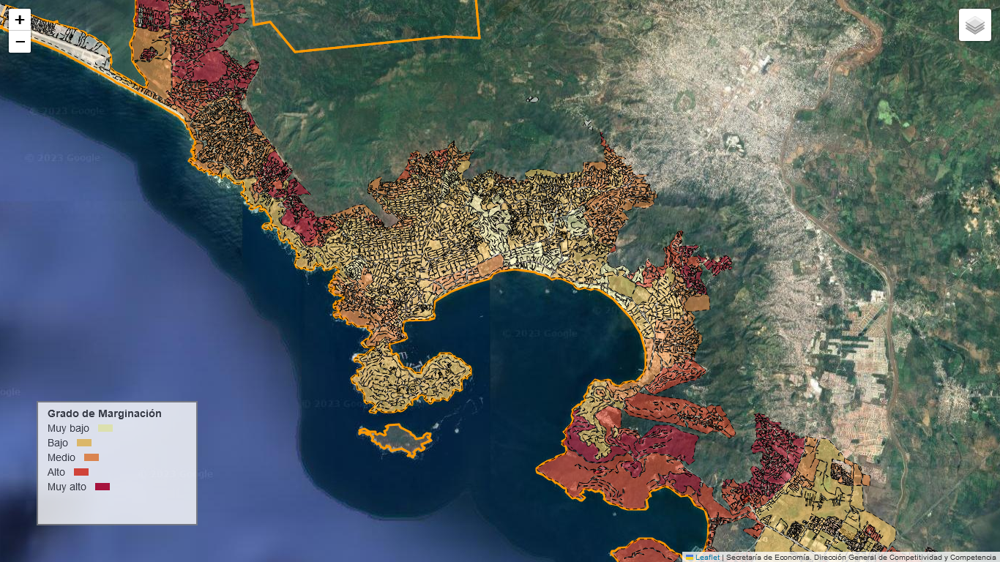

In [483]:

color_mapping = {
    "Muy bajo": "#ffffb2",  # lightest yellow in YlOrRd scheme
    "Bajo": "#fecc5c",     # light orange
    "Medio": "#fd8d3c",    # orange
    "Alto": "#f03b20",     # dark orange/red
    "Muy alto": "#bd0026"  # darkest red in YlOrRd scheme
    }

colormap_copernicus1 = {
    "Destruido": "#8b1a2e",  # bright red
    "Dañado": "#9932cc",    # deep purple
    "Posiblemente dañado": "#ffd700"  # gold/yellow for contrast
}

def get_color(feature):
    gm_value = feature['properties']['gm_2020_left']
    return color_mapping.get(gm_value, '#FFFFFF')

mapa=folium.Map(location=[16.85713,-99.88510],zoom_start=13,tiles="http://www.google.cn/maps/vt?lyrs=s@189&gl=cn&x={x}&y={y}&z={z}",
                attr="Secretaría de Economía. Dirección General de Competitividad y Competencia", png_enabled=True)
#Añadir shape de municipios. Fondo transparente, contorno naranja. Popup con nombre de municipio
municipio_marker=folium.FeatureGroup(name="Municipios afectados")
folium.GeoJson(municipios,style_function=lambda x: {"fillColor":"#ffffff","color":"#ff9900","weight":3,"fillOpacity":0.1},highlight_function=lambda x: {"fillColor":"#000000","color":"#000000","weight":1,"fillOpacity":0.1},tooltip=folium.GeoJsonTooltip(fields=["NOMGEO"],aliases=["Municipio: "])).add_to(municipio_marker)
municipio_marker.add_to(mapa)


#Agregar capa de copernicus1
manzanasgroup = folium.FeatureGroup(name="Marginación, daños y características de las viviendas",show=True)

folium.GeoJson(
    manzanas_copernicus,
    style_function=lambda feature: {
        #Rellenar por grado de marginación
        'fillColor': get_color(feature),
        
        'fillOpacity': 0.5,
        'color': '#000000',   # You can adjust the border color if needed
        'weight': 1,
        'dashArray': '5, 5'  # Dashed borders, remove this if not desired
    },
tooltip=folium.GeoJsonTooltip(fields=["damage_gra","nom_mun","mza", "colonia_left", "tvivparhab", 
                                           "ocupvivpar","prom_ocup", "gm_2020_left"],aliases=["Tipo de daño","Municipio: ","Manzana: ","Colonia: ", "Viviendas particulares habitadas: ",
                                                                                      "Habitantes: ","Promedio de habitantes por vivienda: ",
                                                                                      "Grado de marginación: "])).add_to(manzanasgroup)
manzanasgroup.add_to(mapa)

#Agregar capa de centroides con radio proporcional al número de viviendas
centroidesgroup = folium.FeatureGroup(name="Viviendas existentes",show=False)

# Find the maximum number of houses for color normalization
max_houses = centroides['tvivparhab'].max()

# Loop to add circles to the map
for i in range(0,len(centroides)):
    number_of_houses = centroides.iloc[i]['tvivparhab']  # Get the number of houses
    # Create a popup with the number of houses
    popup = folium.Popup(f'Viviendas: {number_of_houses}', parse_html=True)
    # Create the circle marker with the popup
    folium.Circle(
        location=[centroides.iloc[i]['lat'], centroides.iloc[i]['lon']],
        radius=calculate_radius(number_of_houses),
        color='white',
        fill=True,
        fill_color=get_bubble_color(number_of_houses, max_houses),  # Use the get_bubble_color function here
        fill_opacity=0.7,
        popup=popup  # Add the popup to the circle
    ).add_to(centroidesgroup)

centroidesgroup.add_to(mapa)


# Define the HTML template for the legend
template = """
{% macro html(this, kwargs) %}
<div style="position: fixed; 
     bottom: 50px; left: 50px; width: 220px; height: 170px; 
     border:2px solid grey; z-index:9999; font-size:14px;
     background-color:white; opacity: 0.8; padding: 5px;">
    &nbsp; <b>Grado de Marginación</b> <br>
    &nbsp; Muy bajo &nbsp; <i style="background: #ffffb2; width: 20px; height: 10px; display: inline-block;"></i><br>
    &nbsp; Bajo &nbsp; <i style="background: #fecc5c; width: 20px; height: 10px; display: inline-block;"></i><br>
    &nbsp; Medio &nbsp; <i style="background: #fd8d3c; width: 20px; height: 10px; display: inline-block;"></i><br>
    &nbsp; Alto &nbsp; <i style="background: #f03b20; width: 20px; height: 10px; display: inline-block;"></i><br>
    &nbsp; Muy alto &nbsp; <i style="background: #bd0026; width: 20px; height: 10px; display: inline-block;"></i><br>
</div>
{% endmacro %}
"""


# Create a MacroElement which will be added to the map
macro = MacroElement()
macro._template = Template(template)

# Add the legend to the map
mapa.get_root().add_child(macro)
folium.LayerControl().add_to(mapa)

# To display the map in a Jupyter notebook, you can simply use
mapa

In [485]:
#Guardar mapa
mapa.save("identifica_vivi_gro_copernicus.html")